# Machine Tasting

![Início](http://www.republicwa.org/wp-content/uploads/2017/08/wine-tasting-august.jpg)

# Basic imports

In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats as scistats
import seaborn as sns

%matplotlib inline

# <span style="color:purple">Carga de Dados</span>

Dataset disponível em:

http://mlr.cs.umass.edu/ml/machine-learning-databases/wine-quality/

Variáveis disponíveis:

*fixed acidity / volatile acidity / citric acid / residual sugar / chlorides / free sulfur dioxide / total sulfur dioxide / density / pH / sulphates / alcohol*

Variável alvo (baseada em informação sensorial)

*quality*

In [63]:
df_red_wine_data = pd.read_csv('winequality-red.csv', sep=';')
df_white_wine_data = pd.read_csv('winequality-white.csv', sep=';')

df_wine_data = df_red_wine_data.append(df_white_wine_data)

In [64]:
print("{} vinhos tintos e {} vinhos brancos".format(len(df_red_wine_data), len(df_white_wine_data)))
df_wine_data.head()

1599 vinhos tintos e 4898 vinhos brancos


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


# <span style="color:green">Definição do problema</span>

### Hipótese: 
Os dados físico-químicos de um vinha se traduzem na percepçõa sensorial do mesmo. Com isso, através de uma análise química, podemos classificar um vinho em uma escala de 1 a 10 tão bem (ou melhor) que um degistador profissional.

### Abordagem: 
para verificar nossa hipótese tentaremos desenvolver um classificador que toma como entrada os parâmetros físico-químicos de um vinho e é capaz de dar uma nota de 1 a 10

# <span style="color:purple">1. Análise inicial de dados</span>

## 1.1 Distribuições independentes

- Primeiro vamos analisar a distribuição de cada variavel. 
- Para isso basta exibir o box plot de cada variável do dataframe.

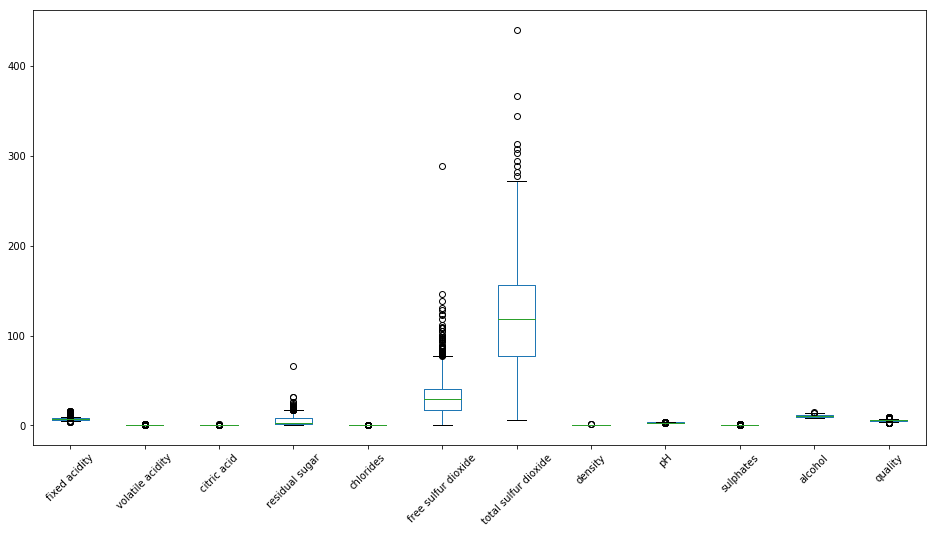

In [65]:
# plota o boxplot de cada coluna do dataframe
df_wine_data.plot.box(figsize=(16, 8))
# apenas ajusta a rotação dos marcadores do eixo x
plt.xticks(rotation=45)
plt.show()

## 1.2 Escalonamento das variáveis

- Vamos transformar as variveis para dentro do intervalo entre 0 e 1.
- Com isso poderemos ver a distribuição relativa entre as variáveis

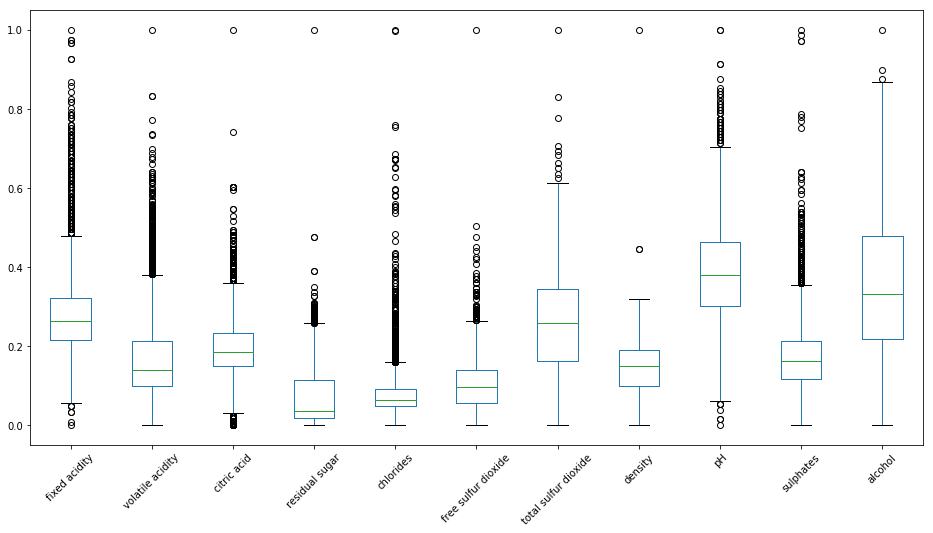

In [66]:
# o escalonamento realizado e muito simples.
# x_escalonado = (x-x_min)/(x_max-x_min)
maximos = df_wine_data.max()
minimos = df_wine_data.min()

df_wine_data_escalonado = (df_wine_data - minimos) / (maximos - minimos)
df_wine_data_escalonado = df_wine_data_escalonado.drop("quality", axis=1)

# ------- OU --------
# from sklearn.preprocessing import MinMaxScaler

# df_wine_data_escalonado = MinMaxScaler().fit_transform(df_wine_data)
# df_wine_data_escalonado = df_wine_data_escalonado.drop("quality", axis=1)

# plota o boxplot de cada coluna do dataframe
df_wine_data_escalonado.plot.box(figsize=(16, 8))
# apenas ajusta a rotação dos marcadores do eixo x
plt.xticks(rotation=45)
plt.show()

## 1.3 Distribuições das variáveis

- Vamos analisar as distribuições de cada variável.
- Para isso, vamos analisar o histograma de cada variável e analisar algumas das estatísticas descritivas

In [67]:
df_wine_data_escalonado.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol'],
      dtype='object')

Estatísicas Descritivas:
Média: 10.491800831152839 / Mediana: 10.3 / Moda: 9.5
Desvio Padrão: 1.1926199559167747


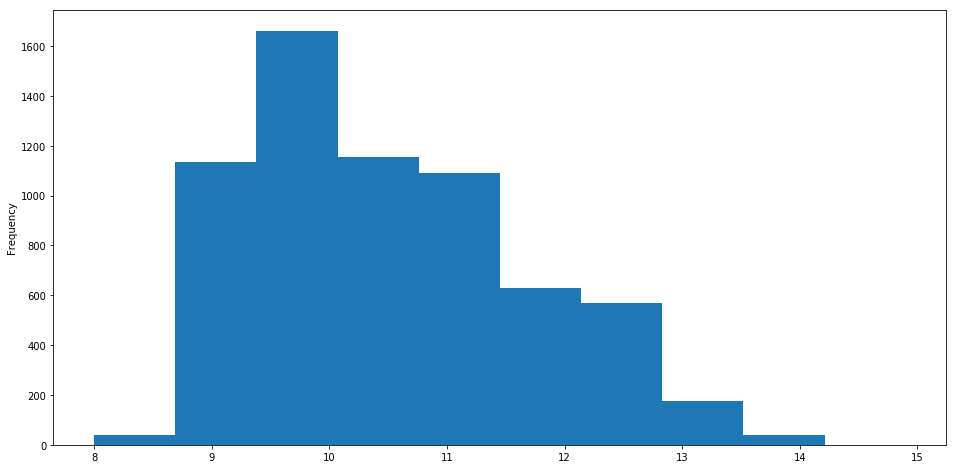

In [68]:
var = "alcohol"

values = df_wine_data[var].tolist()

mean = np.mean(values)
median = np.median(values)
mode = scistats.mode(values)[0][0]
std = np.std(values)

print("Estatísicas Descritivas:")
print("Média: {} / Mediana: {} / Moda: {}".format(mean, median, mode))
print("Desvio Padrão: {}".format(std))

df_wine_data[var].plot.hist(figsize=(16,8))
plt.show()

## 1.4 Correlações

- Algumas das variáveis podem apresentar fortes correlações.
- Devemos eliminar as variáveis correlacionadas antes de aplicar qualquer método de ajuste linear

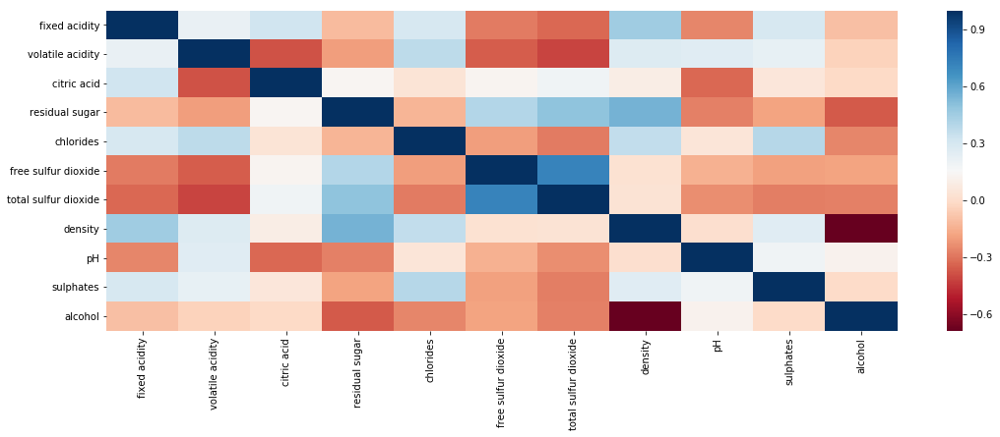

In [69]:
# calcula as correlacoes
correlacoes = df_wine_data_escalonado.corr()
# aqui montamos um heatmap com as correlacoes entre as variaveis
plt.subplots(figsize=(18,6))
sns.heatmap(correlacoes, xticklabels=correlacoes.columns, yticklabels=correlacoes.columns, cmap="RdBu")
plt.show()

Vamos testar se o mapa de correlação realmente indica as variáveis linearmente correlacionadas. Tanto faz trabalharmos com os dados escalonados ou não para análise de correlação.

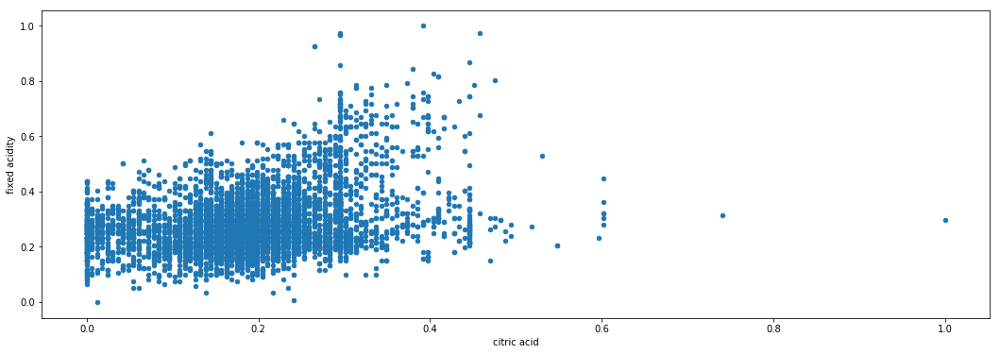

In [70]:
var1 = "citric acid"
var2 = "fixed acidity"

df_wine_data_escalonado.plot.scatter(x=var1, y=var2, figsize=(18,6))
plt.show()

## 1.5 Grupos

- Vamos buscar grupos evidentes nos dados que nos indicam a qualidade dos vinhos

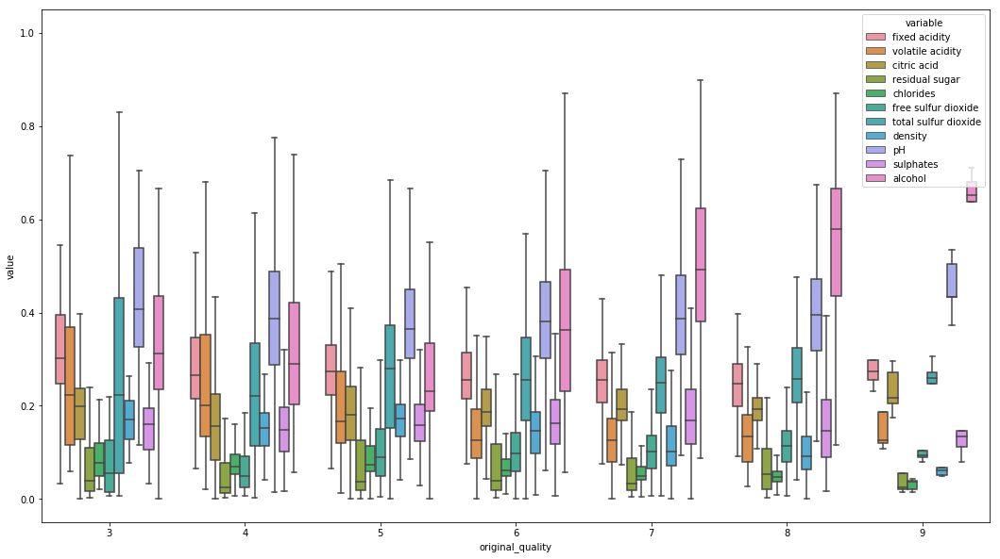

In [71]:
# adiciona a coluna de quality
df_wine_data_escalonado["original_quality"] = df_wine_data["quality"]

# ajusta dataframe para plotar as distribuições de variáveis por grupo
df_analise_grupos = df_wine_data_escalonado.set_index("original_quality").stack().reset_index()
df_analise_grupos.columns = ["original_quality", "variable", "value"]

# monta plot
plt.subplots(figsize=(18,10))
sns.boxplot(data=df_analise_grupos, hue="variable", x = "original_quality", y="value", fliersize=0)
plt.show()

# elimina a coluna de quality
df_wine_data_escalonado = df_wine_data_escalonado.drop(["original_quality"], axis=1)

## 1.6 Frequencia de classes de vinhos e benchmark

- Vamos determinar a frequencia de cada classe
- Isso nos dá o benchmark para o modelo de classificação

In [72]:
df_quality_only = df_wine_data[["quality"]].reset_index()

df_quality_only.groupby("quality").agg("count") / len(df_wine_data)

,index
quality,
3,0.004618
4,0.033246
5,0.329075
6,0.436509
7,0.166077
8,0.029706
9,0.000770


# <span style="color:green">2. Preparacao das amostras de treino e teste</span>

## 2.1 Inclusão do target no dataframe de features

In [73]:
df_data = df_wine_data_escalonado.copy()
df_data["quality"] = df_wine_data["quality"]

df_data.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0.297521,0.413333,0.000000,0.019939,0.111296,0.034722,0.064516,0.206092,0.612403,0.191011,0.202899,5
1,0.330579,0.533333,0.000000,0.030675,0.147841,0.083333,0.140553,0.186813,0.372093,0.258427,0.260870,5
2,0.330579,0.453333,0.024096,0.026074,0.137874,0.048611,0.110599,0.190669,0.418605,0.241573,0.260870,5
3,0.611570,0.133333,0.337349,0.019939,0.109635,0.055556,0.124424,0.209948,0.341085,0.202247,0.260870,6
4,0.297521,0.413333,0.000000,0.019939,0.111296,0.034722,0.064516,0.206092,0.612403,0.191011,0.202899,5


## 2.2 Separação da amostra de treino e teste

In [74]:
# vamos definir uma funcao que recebe o dataframe e uma fracao de separacao e nos 
# retorno os dataframes de treino e teste, separanedo também features e target
def gera_treino_teste(df, fracao):
    n_amostras_treino = int(fracao * len(df))
    n_amostras_teste  = len(df) - n_amostras_treino
    
    df_treino = df.sample(n_amostras_treino)
    df_teste = df.sample(n_amostras_teste)
    
    df_features_treino = df_treino.drop("quality", axis=1)
    df_target_treino = df_treino["quality"] 

    df_features_teste = df_teste.drop("quality", axis=1)
    df_target_teste = df_teste["quality"] 
    
    return df_features_treino, df_target_treino, df_features_teste, df_target_teste

In [75]:
df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.8)

print("Treino - {} features / {} target".format(df_features_treino.shape, df_target_treino.shape))
print("Teste - {} features / {} target".format(df_features_teste.shape, df_target_teste.shape))

Treino - (5197, 11) features / (5197,) target
Teste - (1300, 11) features / (1300,) target


# <span style="color:purple">3. Aplicacao do modelo</span>

- Vamos utilizar a árvore de decisão como modelo para nosso classificador
- Inicialmente vamos testar a configuração padrão do Scikit-Learn
- Como estamos tratando de um problema de classificação com múltiplos outputs vamos balancear as classes
- Em seguida vamos fazer uma otimizacao de parâmetros e cross_valicadao

## 3.1 Teste inicial com configuracao padrão

In [76]:
from sklearn.tree import DecisionTreeClassifier

In [77]:
# teste com a configuracao padrao
df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.8)

clf = DecisionTreeClassifier()
clf.fit(df_features_treino, df_target_treino)

score = clf.score(df_features_teste, df_target_teste)

print("A acurácia do modelo é {}".format(score))

A acurácia do modelo é 0.9284615384615384


## 3.2 Segundo teste variando o sampling dos dados de treino e teste

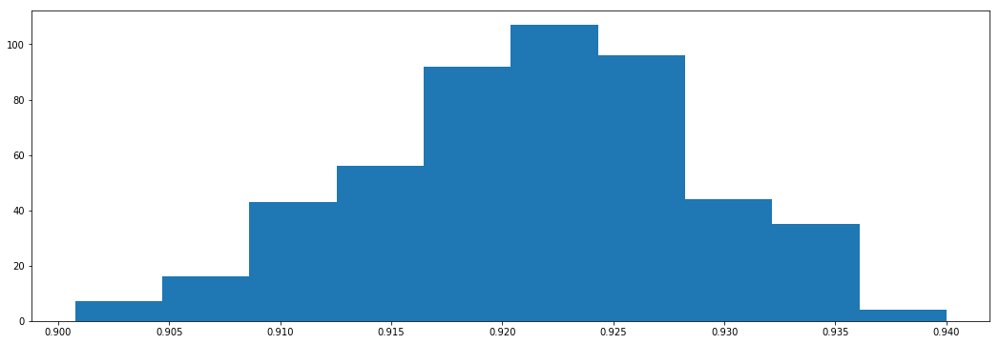

In [78]:
# nao podemos confiar apenas em uma rodada do modelo pois pode ser decorrente da seleção aleatória dos dados. 
# Precisamos validar com múltiplas execuções.

scores = []

for i in range(500):
    df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.8)
    
    clf = DecisionTreeClassifier()
    clf.fit(df_features_treino, df_target_treino)

    score = clf.score(df_features_teste, df_target_teste)
    
    scores.append(score)

plt.subplots(figsize=(18,6))
plt.hist(scores)
plt.show()

## 3.3 Análise dos parâmetros

#### *profundidade da rede*

In [79]:
scores_per_depth = []
# vamos testar a profundidade da arvore de 1 até 50
for depth in range(1, 51):
    if depth % 10 == 0:
        print("Testando profundidade {}".format(depth))
    scores = []
    # para cada profundidade vamos realizar 50 execuções variando o sampling dos dados de treino e teste
    for i in range(50):
        df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.8)
    
        clf = DecisionTreeClassifier(max_depth=depth)
        clf.fit(df_features_treino, df_target_treino)

        score = clf.score(df_features_teste, df_target_teste)

        scores.append(score)
    scores_per_depth.append(scores)

Testando profundidade 10
Testando profundidade 20
Testando profundidade 30
Testando profundidade 40
Testando profundidade 50


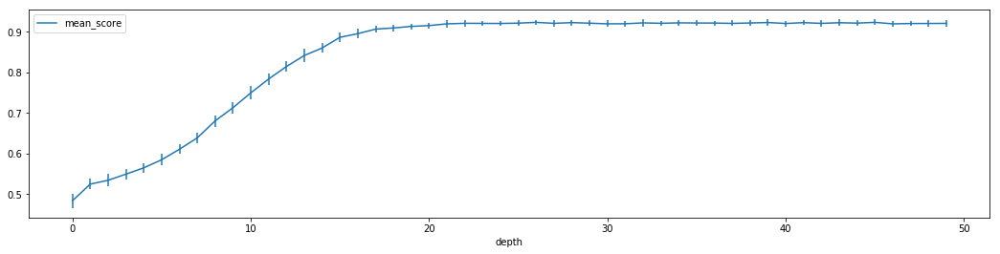

In [80]:
# vamos plotar como o score varia com o aumento da profundidade da rede, analisando também a dispersão dos resultados
df_profundidade_vs_score = pd.DataFrame(scores_per_depth).stack().reset_index()
df_profundidade_vs_score.columns = ["depth", "round", "score"]
df_profundidade_vs_score = df_profundidade_vs_score.groupby("depth", as_index=False).agg({"score": ["mean", "std"]})
df_profundidade_vs_score.columns = ["depth", "mean_score", "std_score"]
df_profundidade_vs_score.plot(x="depth", y="mean_score", yerr="std_score", figsize=(18,4))

#### *sampling*

In [81]:
score_per_sampling_ratio = []
for sampling in [0.5, 0.6, 0.7, 0.8, 0.9]:
    scores = []
    for i in range(50):
        df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, sampling)
    
        clf = DecisionTreeClassifier(max_depth=25)
        clf.fit(df_features_treino, df_target_treino)

        score = clf.score(df_features_teste, df_target_teste)

        scores.append(score)
    score_per_sampling_ratio.append(scores)

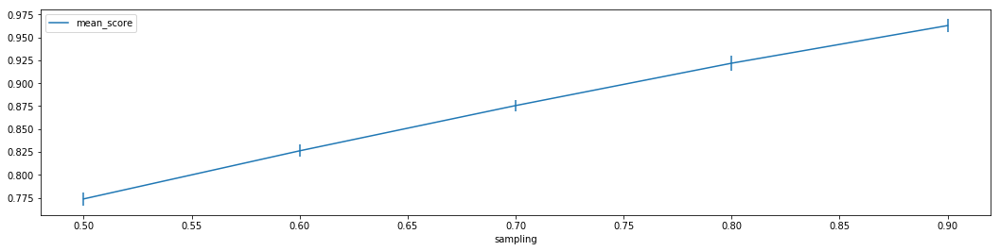

In [82]:
df_profundidade_vs_sampling = pd.DataFrame(score_per_sampling_ratio).stack().reset_index()
df_profundidade_vs_sampling.columns = ["sampling", "round", "score"]
df_profundidade_vs_sampling["sampling"] = df_profundidade_vs_sampling["sampling"].apply(lambda x: 0.5 + 0.1*x)
df_profundidade_vs_sampling = df_profundidade_vs_sampling.groupby("sampling", as_index=False).agg({"score": ["mean", "std"]})
df_profundidade_vs_sampling.columns = ["sampling", "mean_score", "std_score"]
df_profundidade_vs_sampling.plot(x="sampling", y="mean_score", yerr="std_score", figsize=(18,4))

##### O comportamento do score com o sampling está estranho, vamos ver as previsões para ver o que o modelo está aprendendo.

In [83]:
df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.5)
clf = DecisionTreeClassifier(max_depth=25)
clf.fit(df_features_treino, df_target_treino)
predictions = clf.predict(df_features_teste)
predictions = pd.Series(predictions)
predictions.name = "predicted_quality"

In [84]:
contagem_target    = pd.DataFrame(df_target_teste.value_counts())
contagem_previsoes = pd.DataFrame(predictions.value_counts())
df_comparacao_previsoes = contagem_target.join(contagem_previsoes)
df_comparacao_previsoes

,quality,predicted_quality
6,1433,1392
5,1064,1074
7,529,534
4,111,126
8,92,100
3,17,17
9,3,6


##### Aparentemente a distribuição das previsões está aderente à distribuição dos valores reais do Target. Isso não significa que o modelo esteja prevendo corretamente, mas tira a desconfiança de que o modelo esteja aprendendo somente as classes mais prováveis.

In [85]:
# vamos analisar algumas previsões erradas
predictions.index = df_target_teste.index
df_previsoes_vs_real = pd.DataFrame(predictions)
df_previsoes_vs_real["quality"] = df_target_teste
df_previsoes_vs_real["check"] = df_previsoes_vs_real["quality"] == df_previsoes_vs_real["predicted_quality"]
df_previsoes_vs_real[df_previsoes_vs_real.check == False].head()

,predicted_quality,quality,check
1377,5,6,False
333,6,5,False
2079,5,4,False
278,5,4,False
2984,8,6,False


## 3.3 Balanceamento de classes

In [86]:
# vamos resgatar a contagem de frequencia de cada classe
df_quality_only = df_wine_data[["quality"]].reset_index()
df_quality_only = df_quality_only.groupby("quality").agg("count") / len(df_wine_data)
df_quality_only.columns = ["class_frequency"]

df_quality_only["class_weight"] = df_quality_only["class_frequency"].apply(lambda x: 1/x)
df_quality_only

,class_frequency,class_weight
quality,,
3,0.004618,216.566667
4,0.033246,30.078704
5,0.329075,3.038821
6,0.436509,2.290903
7,0.166077,6.021316
8,0.029706,33.663212
9,0.000770,1299.400000


In [87]:
class_weights = df_quality_only["class_weight"].to_dict()

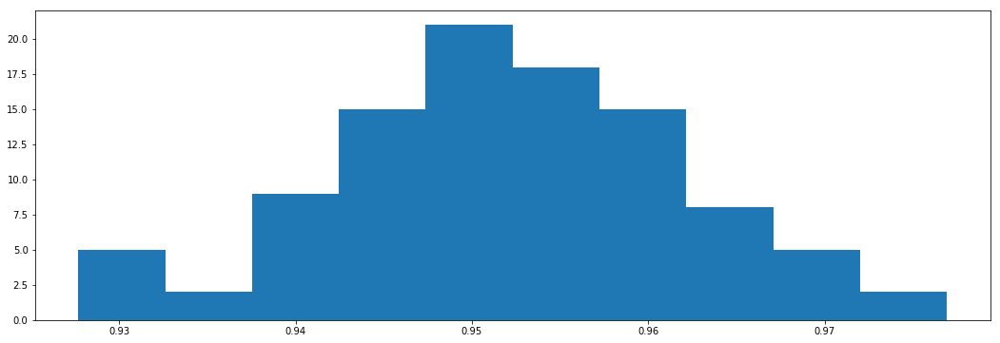

In [88]:
scores = []
for i in range(100):
    df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.9)
    clf = DecisionTreeClassifier(max_depth=25, class_weight=class_weights)
    clf.fit(df_features_treino, df_target_treino)
    score = clf.score(df_features_teste, df_target_teste)
    scores.append(score)
plt.subplots(figsize=(18,6))
plt.hist(scores)
plt.show()

## 3.4 Visualizando o modelo

In [89]:
df_features_treino, df_target_treino, df_features_teste, df_target_teste = gera_treino_teste(df_data, 0.9)
clf = DecisionTreeClassifier(max_depth=25, class_weight=class_weights)
clf.fit(df_features_treino, df_target_treino)

DecisionTreeClassifier(class_weight={3: 216.56666666666666, 4: 30.078703703703702, 5: 3.038821328344247, 6: 2.2909026798307477, 7: 6.021316033364227, 8: 33.66321243523316, 9: 1299.4},
            criterion='gini', max_depth=25, max_features=None,
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [90]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import datasets
from IPython.display import Image  
from sklearn import tree
import pydotplus

# Cria DOT file
dot_data = tree.export_graphviz(clf, out_file=None, 
                                feature_names=df_features_treino.columns, 
                                class_names=[str(i) for i in df_target_treino.unique()])

# Desenha gráfico
graph = pydotplus.graph_from_dot_data(dot_data)  

# Plota graph
Image(graph.create_png())

# Cria png do gráfico
# graph.write_png("tree.png")

# Cria pdf do gráfico
# graph.write_png("tree.pdf")

# Obrigado

### Perguntas: luiz.andrade@tevec.com.br

![Final](https://www.slowtourtuscany.it/public/img/tours/6fccdc8b-5aed-4e07-a1a5-cebf8c6c2275/img_0.jpg)